# Analyzing NIH grant abstracts to predict total funds awarded

Our goal is to attempt to predict how much funding a grant is awarded based on the grant abstract and the number of years a grant is funded. We will also identify funding/research trends over the years. The code to obtain these data and perform initial cleaning can be found [here](download-clean-data.ipynb).

Here we will perform preprocessing of the abstract text data.

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import nltk
from nltk.tokenize import WhitespaceTokenizer
from nltk.tokenize import RegexpTokenizer
from nltk.text import Text
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
import string

from sklearn.externals import joblib
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.naive_bayes import MultinomialNB
from sklearn.manifold import MDS
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

[Local functions](https://github.com/yuwie10/nih-awards/blob/master/nih_functions.py) for this project.

In [2]:
import nih_functions as nih
import importlib as imp
imp.reload(nih);

First we load the dataset with abstract information.

In [3]:
cols = pd.read_csv('phr.csv', compression = 'gzip', nrows = 1)

dates = ['project_start', 'project_end']
numeric = ['funds', 'support_year', 'num_pis']

#get dtypes
dtypes = nih.get_dtypes(cols, numeric)

phr = pd.read_csv('phr.csv', compression = 'gzip',
                  dtype = dtypes, parse_dates = dates)

Let's explore the abstract column a little.

In [4]:
phr['phr'] = phr['phr'].str.strip()

In [5]:
phr['phr'].head()
phr['phr'].tail()

0    we have previously shown that 30-year old trea...
1    the proposed research will be directly relevan...
2    public health relevance statement liver toxici...
3    habitual alcohol drinking and cue-induced rela...
4    alcohol addiction is a chronically relapsing d...
Name: phr, dtype: object

191121    project narrative pancreatic tumors have a set...
191122    project narrative trauma-exposed adolescents a...
191123    narrative nicotine addiction is the leading pr...
191124    public health relevance: hepatocarinoma is a m...
191125    public health relevance:  trip13 overexpressio...
Name: phr, dtype: object

Many of the abstracts begin with the strings 'project narrative' or 'public health relevance'. Let's first remove these phrases and any extraneous white spaces.

In [6]:
def strip_begin(s, text):
    if s.startswith(text):
        return s[len(text):]
    return s

In [7]:
strings = ['public health relevance', ' statement', 'project narrative', 'narrative']

phr_list = []
for s in phr['phr']:
    for idx, _ in enumerate(strings):
        s = strip_begin(s, strings[idx])
    phr_list.append(s)

There are several entries where instead of white spaces, words are separated by a closed parenthesis ')'. We will need to replace these symbols with 

In [8]:
phr.loc[[15027]]

,application_id,activity,application_type,arra_funded,funding_mechanism,fy,nih_spending_cats,phr,project_start,project_end,project_terms,study_section,study_section_name,support_year,funds,pi_ids,num_pis
15027,7985190,r01,2,n,research projects,2010,neurosciences;eye disease and disorders of vis...,this)grant)proposal)will)address)the)function)...,1984-08-01,2013-08-31,address;amacrine cells;analog;applications gra...,bdpe,biology and diseases of the posterior eye,27.0,395192.0,1933612,1.0


In [9]:
for idx, s in enumerate(phr_list):
    #there will be a lot of abbreviations, so ignore these parantheses
    if '(' not in s:
        phr_list[idx] = s.replace(')', ' ')

Check that the list of cleaned abstracts is the same length as the dataframe.

In [10]:
len(phr_list)
len(phr)

191126

191126

Add the cleaned abstracts to the dataframe.

In [11]:
phr['phr_cleaned'] = phr_list
#del phr['phr']

In [12]:
phr['phr_cleaned'] = phr['phr_cleaned'].str.strip(': ')

In [13]:
phr.head()

,application_id,activity,application_type,arra_funded,funding_mechanism,fy,nih_spending_cats,phr,project_start,project_end,project_terms,study_section,study_section_name,support_year,funds,pi_ids,num_pis,phr_cleaned
0,7582101,r01,2,NaN,NaN,2008,alcoholism;basic behavioral and social science...,we have previously shown that 30-year old trea...,2002-06-01,NaT,"1,3,7-trimethylxanthine;1h-purine-2,6-dione, 3...",nal,neurotoxicology and alcohol study section,6.0,620924.0,7356212,1.0,we have previously shown that 30-year old trea...
1,7620149,r01,1,NaN,NaN,2008,alcoholism;behavioral and social science;infec...,the proposed research will be directly relevan...,2008-09-30,NaT,aids;aids virus;absolute ethanol;acquired immu...,ace,aids clinical studies and epidemiology study s...,1.0,329599.0,8616018,1.0,the proposed research will be directly relevan...
2,7589274,r01,1,NaN,NaN,2008,alcoholism;chronic liver disease and cirrhosis...,public health relevance statement liver toxici...,2008-09-30,NaT,"3-heptanone, 6-(dimethylamino)-4,4-diphenyl-;6...",zaa1,special emphasis panel,1.0,437882.0,1891463,1.0,liver toxicity in hiv disease is a common occu...
3,7590863,r01,1,NaN,NaN,2008,alcoholism;basic behavioral and social science...,habitual alcohol drinking and cue-induced rela...,2008-09-30,NaT,"3,4-dihydroxyphenethylamine;3,4-dihydroxypheny...",zaa1,special emphasis panel,1.0,279236.0,6608090,1.0,habitual alcohol drinking and cue-induced rela...
4,7590746,r01,1,NaN,NaN,2008,alcoholism;basic behavioral and social science...,alcohol addiction is a chronically relapsing d...,2008-09-30,NaT,"8-azabicyclo(3.2.1)octane-2-carboxylic acid, 3...",zaa1,special emphasis panel,1.0,402688.0,1862383,1.0,alcohol addiction is a chronically relapsing d...


For this analysis we are not investigating grants awarded per PI or per institution. Therefore we can drop duplicate grants (identified by application_id, which is unique per year) and multiply the funding column by the number of PIs to get total funding awarded per individual grant. Also we will drop any rows where the funding information is not available.

In [14]:
phr = phr.drop_duplicates('application_id')
phr['funds'] = phr['funds'] * phr['num_pis']
phr = phr.ix[phr['funds'].notnull()]

## Tf-idf

In [15]:
all_text = phr['phr_cleaned'].tolist()

Let's get a sense of the lengths of our abstracts (this includes punctuation and stop words).

In [16]:
lengths = pd.DataFrame([len(s) for s in all_text])
lengths.describe()

,0
count,163532.000000
mean,596.803782
std,329.296318
min,1.000000
25%,425.000000
50%,540.000000
75%,689.000000
max,21214.000000


For tf-idf analysis, we need to tokenize and stem our text. We will use NLTK's RegexpTokenizer to remove non-alphanumeric symbols and will test lemmatization and stemming.

In [17]:
#removes any non-alphanumeric symbols
tokenizer = RegexpTokenizer(r'\w+')
lemmatizer = WordNetLemmatizer()
stemmer = SnowballStemmer('english')

In [18]:
def get_tokens_stems(text, tokenizer = tokenizer,
                     stem = True, stemmer = stemmer,
                     lemma = False, lemmatizer = lemmatizer):
    
    #get tokens
    all_text = tokenizer.tokenize(text)
    
    if lemma:
        #get word lemmas
        all_text = [lemmatizer.lemmatize(word) for word in all_text]
    
    if stem:
        #get word stems
        all_text = [stemmer.stem(word) for word in all_text]
    
    return all_text

Lemmatization and stemming results in mapping of potentially many words to the lemma/stem. We want to be able to look up the words associated with a particular lemma/stem for future reference. Therefore let's map words to their corresponding stemmed version.

In [19]:
def map_words_to_stems(list_words, list_roots):
    
    '''
    Given a list of words and list of lemmas/stems,
    return a dictionary with the lemma/stem as keys
    and a list of words with that lemma/stem as values
    '''
    
    dict_roots = {}
    for word, root in zip(list_words, list_roots):
        
        #we don't need to store the word if it is not stemmed
        if root != word:
            
            #if the lemma/stem is already a key in the dictionary
            if root in dict_roots:
                
                #if the word is not already listed
                if word not in dict_roots[root]:
                    dict_roots[root].append(word)
            else:
                #add lemma/stem as key and word as value
                dict_roots[root] = [word]
    
    return dict_roots

In [36]:
for text in all_text:
    
    #get list of tokenized words and lemmas/stems
    #for each abstract
    list_words = get_tokens_stems(text, stem = False)
    list_lemmas = [lemmatizer.lemmatize(word) for word in list_words]
    list_stems = [stemmer.stem(word) for word in list_words]

dict_lemmas = map_words_to_stems(list_words, list_lemmas)
dict_stems = map_words_to_stems(list_words, list_stems)

In [87]:
len(dict_lemmas)
len(dict_stems)

4358

15960

There are far fewer lemmas than stemmed roots. If we examine the lemmas we see that it seems to mostly be shortening plural words to their singular forms. We will have to be cognizant that our lemmatizer stemmed abbreviations, including transforming 'aids' (AIDS) to 'aid' and 'us' (US) to 'u'.

Stemming using the snowball stemmer, on the other hand, seems to better handle different tenses and forms of words, so we will use the snowball stemmer. Let's save both dictionaries as JSON files for future reference.

In [20]:
import json

#uncomment to write dicts to JSON files
#with open('lemmas.txt', 'w') as outfile:
#    json.dump(dict_lemmas, outfile)

#with open('stems_snowball.txt', 'w') as outfile:
#    json.dump(dict_stems, outfile)

#read JSON files
with open('stems_snowball.txt', 'r') as json_data:
    dict_stems = json.load(json_data)

Let's also create a dataframe with all the vocabulary in the NIH abstract corpus following stemming.

In [21]:
vocab = []
for text in all_text:
    vocab.append(get_tokens_stems(text))

vocab = [item for sublist in vocab for item in sublist]

all_vocab = pd.DataFrame({'vocab':vocab})
all_vocab.drop_duplicates(inplace = True)
all_vocab.shape

(35576, 1)

Including stop words, there are over 35,000 unique words in the abstracts, which is relatively small for a text corpus. As the abstracts themselves are short, this is unsurprising.

We will also remove stop words from our corpus. In addition to the normal English stop words, we need to remove common generic research terms. Let's define a list of stop words for the NIH grant abstracts.

In [22]:
research_terms = ['proposal', 'propose', 'proposed', 'involve', 'public', 'health', 
                  'significance', 'significant', 'goal', 'research', 'relevant', 
                  'relevance', 'project', 'narrative', 'study', 'work', 'understand',
                  'result', 'statement', 'address', 'may', 'use', 'unreadable',
                  'investigate', 'investigation', 'also', 'provide', 'new', 'novel',
                  'application', 'approach', 'approximately', 'associated', 'because']

Some of these words should map to the same stems. Let's replace these words with their corresponding stems.

In [23]:
for i, term in enumerate(research_terms):
    for key, values in dict_stems.items():
        if term in values:   
            #replace word with stemmed version
            research_terms[i] = key

#get unique elements in research_terms
research_terms = list(set(research_terms))

Add our research terms to NLTK's stop words list.

In [24]:
stopwords = nltk.corpus.stopwords.words('english')
my_stops = stopwords + research_terms

We can now vectorize our text via tf-idf transformation using our self-defined tokenization/stemming function and stop words list. We will set min_df (the minimum number of documents the word/phrase must appear in to be considered as a feature) to 500, as this seems to give a good balance between identifying words that may be useful for analyzing abstracts without including too many words (features). We also will keep the default ngram_range to be (1, 1), as bigrams and trigrams in our dataset are redundant.

In [222]:
vectorizer = TfidfVectorizer(max_df = 0.8, min_df = 500, stop_words = my_stops,
                             tokenizer = get_tokens_stems, 
                             lowercase = False, max_features = 200000,
                             use_idf = True, ngram_range = (1, 1))

In [226]:
%time tfidf_matrix = vectorizer.fit_transform(all_text)
tfidf_matrix.shape
terms = vectorizer.get_feature_names()

CPU times: user 3min 43s, sys: 592 ms, total: 3min 44s
Wall time: 3min 45s


(163532, 1745)

### Clustering
We will use mini-batch K-Means.

In [134]:
num_clusters = 20
batch_size = round(0.05 * tfidf_matrix.shape[0])

km = MiniBatchKMeans(n_clusters = num_clusters,
                     batch_size = batch_size)

%time km.fit(tfidf_matrix)

clusters = km.labels_.tolist()

CPU times: user 3.76 s, sys: 216 ms, total: 3.98 s
Wall time: 4.17 s


MiniBatchKMeans(batch_size=8177, compute_labels=True, init='k-means++',
        init_size=None, max_iter=100, max_no_improvement=10, n_clusters=20,
        n_init=3, random_state=None, reassignment_ratio=0.01, tol=0.0,
        verbose=0)

Save and re-load trained K-Means model.

In [28]:
#joblib.dump(km, 'clusters_km.pkl')

num_clusters = 20
km_fit = joblib.load('clusters_km.pkl')
clusters = km_fit.labels_.tolist()

To see which terms were used to cluster the grants, we can pull out the top ten words closest to the cluster centroids.

In [29]:
#sorted centroids
order_centroids = km_fit.cluster_centers_.argsort()[:, ::-1] 

num_words = 10

cluster_vocab = pd.DataFrame()
for i in range(num_clusters):
    centroid_words = []
    
    #for each cluster, get the words closest to 
    #the cluster center
    for idx in order_centroids[i, :num_words]:
        centroid_words.append(terms[idx])
    cluster_vocab['cluster ' + str(i)] = centroid_words

In [30]:
cluster_vocab

,cluster 0,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,cluster 8,cluster 9,cluster 10,cluster 11,cluster 12,cluster 13,cluster 14,cluster 15,cluster 16,cluster 17,cluster 18,cluster 19
0,alcohol,receptor,brain,hiv,liver,cell,age,patient,children,infect,parasit,heart,gene,imag,lung,diseas,cancer,protein,dna,pathogen
1,smoke,tumor,disord,infect,diseas,stem,sleep,treatment,obes,virus,iron,failur,express,kidney,injuri,mechan,breast,drug,genet,bacteri
2,tobacco,signal,neuron,1,hepat,tumor,relat,pain,intervent,vaccin,malaria,cardiac,diseas,method,inflamm,human,tumor,structur,genom,bacteria
3,cocain,activ,function,aid,fatti,cancer,cognit,improv,risk,immun,drug,diseas,human,develop,diseas,regul,prostat,diseas,human,antibiot
4,addict,target,memori,risk,alcohol,immun,diseas,effect,diabet,viral,infect,caus,regul,diseas,inflammatori,signal,cell,develop,diseas,infect
5,effect,regul,neural,intervent,cancer,diseas,declin,clinic,behavior,cell,diseas,death,mutat,patient,asthma,cell,therapi,target,sequenc,resist
6,abus,cell,circuit,drug,cirrhosi,regul,older,care,adolesc,host,caus,blood,develop,mri,pulmonari,develop,target,function,repair,host
7,drink,mechan,develop,prevent,metabol,develop,function,develop,effect,respons,develop,attack,genet,clinic,mechan,function,develop,biolog,mutat,diseas
8,behavior,therapeut,mechan,transmiss,caus,mechan,increas,therapi,prevent,human,human,lead,identifi,detect,airway,molecular,patient,enzym,cancer,immun
9,treatment,role,cognit,antiretrovir,develop,function,popul,diseas,social,develop,host,mechan,caus,improv,acut,pathway,treatment,membran,chromosom,human


We can immediately see that K-Means identified different research subjects, such as research regarding addiction and addictive substances (cluster 0) and HIV/AIDS research (cluster 3). This is confirmation that our unsupervised clustering was able to identify structure within our abstract data.

We will assign each cluster a label based on the top 10 vocabulary words closest to the cluster centroid. These labels will by definition be rather broad, but they do seem to capture general research categories.

In [ ]:
cluster_labels = {
    0:'substance abuse/addiction',
    1:'cell signaling',
    2:'neuroscience',
    3:'hiv',
    4:'liver research',
    5:'cancer cell biology',
    6:'sleep/ageing',
    7:'clinical research',
    8:'child obesity/diabetes',
    9:'virology',
    10:'parasitology (malaria)',
    11:'cardiac research',
    12:'gene expression',
    13:'kidney research and imaging',
    14:'lung research',
    15:'human disease mechanisms',
    16:'cancer research',
    17:'drug development',
    18:'genetics and genomics',
    19:'bacteriology'
}

Let's add the cluster assignments and labels to our original dataframe.

In [31]:
phr['cluster'] = clusters
phr['cluster_labels'] = clusters
phr['cluster_labels'].replace(cluster_labels, inplace = True)

In [100]:
phr['cluster_labels'].value_counts()

human disease mechanisms       21501
clinical research              20042
child obesity/diabetes         13130
neuroscience                   12686
cancer cell biology            11495
cancer research                10889
drug development                9071
gene expression                 7209
genetics and genomics           6244
virology                        6150
kidney research and imaging     6056
lung research                   5900
hiv                             5475
bacteriology                    5245
cell signaling                  4900
sleep/ageing                    4753
substance abuse/addiction       4607
cardiac research                4520
liver research                  2020
parasitology (malaria)          1639
Name: cluster_labels, dtype: int64

Plotting the distribution of funds by abstract cluster (grants with awarded funds greater than $1,000,000 not shown), we see that the peak of the funds by cluster are similar, although it looks like there may be some differences in the shape of the distributions.

/usr/local/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The set_color_cycle attribute was deprecated in version 1.5. Use set_prop_cycle instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


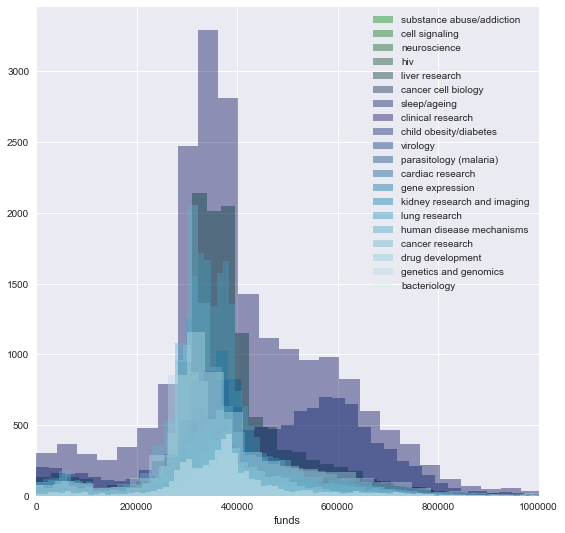

In [103]:
from cycler import cycler

num_colors = 20
cm = plt.get_cmap('ocean')

fig, ax = plt.subplots()
fig.set_size_inches(9, 9);

ax.set_color_cycle([cm(1.*i/num_colors) for i in range(num_colors)])
for i in range(20):
    _ = sns.distplot(phr.ix[phr['cluster'] == i]['funds'],
                     bins = 200, label = cluster_labels[i], kde = False)

_ = plt.legend()
_ = plt.xlabel('funds')
_ = plt.xlim(0, 1000000)

The large degree of overlap makes it difficult to resolve individual grant clusters. Let's visualize the data as violin plots, both with and without extreme values.

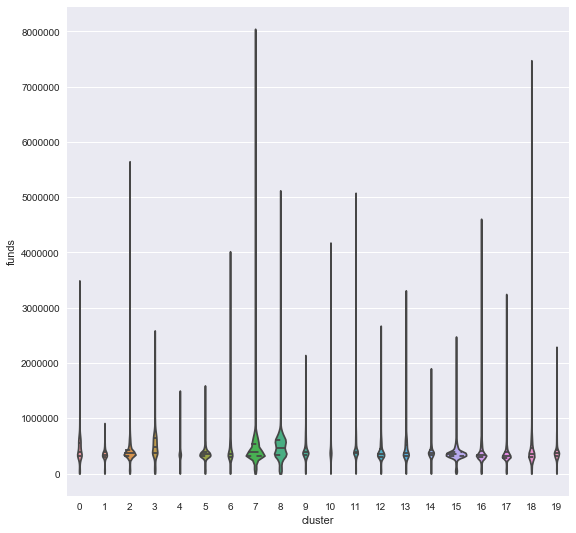

In [115]:
fig, ax = plt.subplots()
fig.set_size_inches(9, 9);
_ = sns.violinplot(x = 'cluster', y = 'funds', data = phr,
                  scale = 'count', inner = 'quartile')

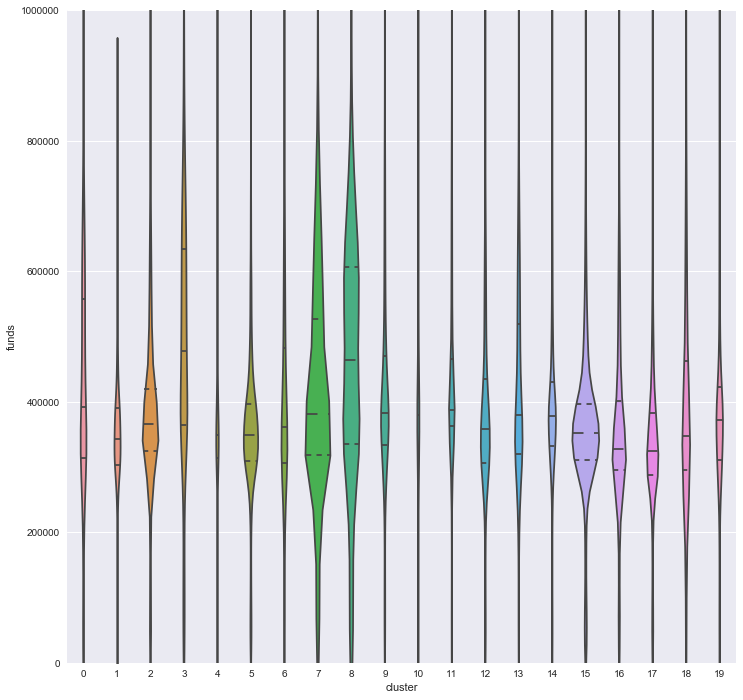

In [126]:
fig, ax = plt.subplots()
fig.set_size_inches(12, 12);
_ = sns.violinplot(x = 'cluster', y = 'funds', data = phr.ix[phr['funds'] > 1000],
                  scale = 'count', inner = 'quartile', bw = 0.2)
_ = plt.ylim(0, 1000000)

What is the mean amount of funding awarded per grant in each cluster?

In [109]:
phr.groupby('cluster_labels')['funds'].mean().sort_values(ascending = False)

cluster_labels
hiv                            499690.516712
child obesity/diabetes         482591.196116
cardiac research               434476.394248
kidney research and imaging    433162.161328
substance abuse/addiction      432384.346863
clinical research              431154.973406
virology                       423786.623415
genetics and genomics          419941.639174
sleep/ageing                   418262.839470
parasitology (malaria)         404944.325198
bacteriology                   396290.501239
lung research                  393594.535085
neuroscience                   386604.039808
gene expression                385651.485227
liver research                 369902.885149
cancer research                363345.147029
human disease mechanisms       359193.577089
cancer cell biology            356938.631492
cell signaling                 346228.160612
drug development               340855.400066
Name: funds, dtype: float64

## Cluster visualization

### Determining funding groups

Let's try and visualize our clusters based on abstract text. To get a sense of how well the clusters correspond to awarded funds, we will need to group the grants by amount of funding each grant received.

We already dropped any grants where funding information was not available; however, there are still grants where the awarded funds seem low, particularly those where the amount awarded is less than $1000 (funds are per year).

In [167]:
unusually_low = phr.ix[phr['funds'] < 1000]
unusually_low['funds'].value_counts()

1.0      130
0.0       24
2.0        2
749.0      1
612.0      1
417.0      1
300.0      1
636.0      1
750.0      1
835.0      1
10.0       1
852.0      1
100.0      1
80.0       1
466.0      1
367.0      1
196.0      1
956.0      1
Name: funds, dtype: int64

It seems likely that these amounts were entered incorrectly. Let's drop these entries.

In [168]:
phr_filtered_funds = phr.drop(unusually_low.index)

We will now divide the grants into funding percentiles; using percentiles rather than mean +/- std guarantees that each funding group we define will have equal representation. First we need to determine the cutoff values for each percentile. We will then assign each grant to a particular funding group based on where the grant falls relative to the cutoff values.

In [169]:
percentiles = ['25%', '50%', '75%']

cutoffs = []
for percentile in percentiles:
    cutoffs.append(phr_filtered_funds.describe()['funds'][percentile])

In [170]:
#copy funding information
phr_filtered_funds['funding_group'] = phr_filtered_funds['funds']

#lowest 25th percentile
phr_filtered_funds.ix[phr_filtered_funds['funds'] < cutoffs[0], 'funding_group'] = 0

#25th-50th percentile
phr_filtered_funds.ix[(phr_filtered_funds['funds'] >= cutoffs[0]) & 
                      (phr_filtered_funds['funds'] < cutoffs[1]),
                      'funding_group'] = 1

#50th-75th percentile
phr_filtered_funds.ix[(phr_filtered_funds['funds'] >= cutoffs[1]) & 
                      (phr_filtered_funds['funds'] < cutoffs[2]),
                      'funding_group'] = 2

#highest percentile
phr_filtered_funds.ix[phr_filtered_funds['funds'] >= cutoffs[2], 
                      'funding_group'] = 3

### Subsampling prior to dimensionality reduction

Our tfidf matrix has over 160,000 entries and over 1700 features (tfidf importance score). This is too large for most dimensionality reduction techniques to handle, therefore we will subsample our data. We want to preserve the relative cluster sizes, therefore we will randomly select 5% of each cluster.

In [262]:
subsamples = pd.DataFrame()
for cluster in range(num_clusters):
    #get size of each cluster
    total_group_size = phr_filtered_funds['cluster'].value_counts()[cluster]
    sample_size = int(round(0.05 * total_group_size))
    subsample = phr_filtered_funds.ix[phr_filtered_funds['cluster'] == cluster].sample(sample_size)
    subsamples = subsamples.append(subsample)

In [265]:
subsamples.shape

(8167, 21)

As we have a smaller document corpus, we need to vectorize with a smaller minimum number of documents to consider.

In [266]:
vect = TfidfVectorizer(max_df = 0.8, min_df = 50, stop_words = my_stops, 
                       lowercase = False, tokenizer = get_tokens_stems)
%time tfidf_subsample = vect.fit_transform(subsamples['phr_cleaned'].tolist())

CPU times: user 11.1 s, sys: 23.7 ms, total: 11.1 s
Wall time: 11.1 s


In [267]:
tfidf_matrix.shape
tfidf_subsample.shape

(163532, 1745)

(8167, 1138)

### t-SNE

In [304]:
from sklearn.manifold import TSNE

In [312]:
learning_rates = [100, 250, 500, 750, 1000]
fitted_tsnes = []

for rate in learning_rates:
    tsne = TSNE(learning_rate = rate)
    fitted_tsnes.append(tsne.fit_transform(tfidf_subsample.toarray()))

In [ ]:
tsne_test = TSNE(learning_rate = 100, n_iter = 5000)
%time tsne_test = tsne_test.fit_transform(tfidf_subsample.toarray())

In order to visualize all 20 clusters, we need to generate 20 colors that are as different as possible so the clusters are as distinct as possible. The code to accomplish this was downloaded from [here](https://gist.github.com/adewes/5884820).

In [292]:
import random
import generate_random_color as gen

In [297]:
colors = []
for i in range(20):
    colors.append(gen.generate_new_color(colors, pastel_factor = 0.9))

Match each color with a cluster label.

In [300]:
cluster_colors = {}
for label, color in zip(subsamples['cluster_labels'].unique(), colors):
    cluster_colors[label] = color

The clusters are best separated when the learning rate is 1000; for brevity only these results are plotted.

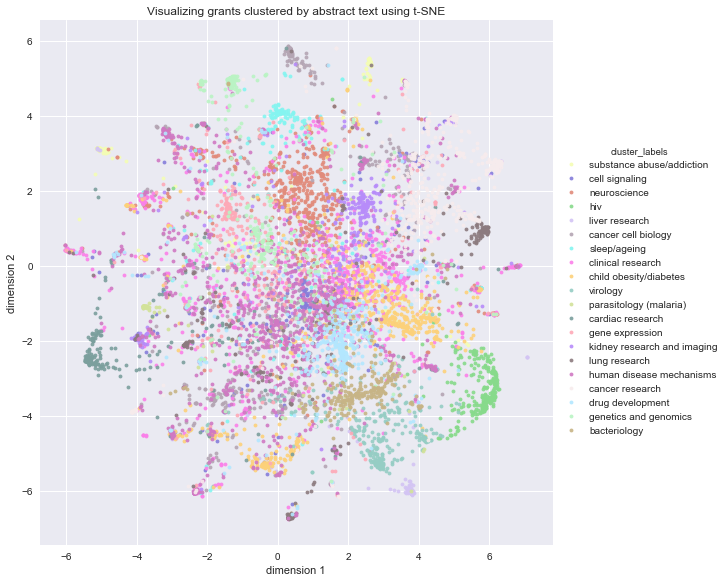

In [328]:
tsne_df = pd.DataFrame(fitted_tsnes[-1], columns = ['dimension 1', 'dimension 2'], index = subsamples.index)
tsne_df['cluster_labels'] = subsamples['cluster_labels']

ax = sns.lmplot('dimension 1', 'dimension 2', tsne_df, hue = 'cluster_labels',
                fit_reg = False, palette = cluster_colors, 
                size = 8, scatter_kws = {'alpha':0.9, 's':15})
_ = ax.set(title = 'Visualizing grants clustered by abstract text using t-SNE')

## Predicting funding group based on grant abstract

For our initial analysis, we will attempt to predict which funding percentile group a grant falls into based on tf-idf of the abstracts. Although we will lose some information by grouping grants in this manner rather than running a regression, we will eventually include high-cardinal variables in our predictive models, and these are more easily incorporated in classification rather than regression tasks. Furthermore, because the majority of grants received very similar amounts of funding, the loss of information will not be too extreme. Finally, we want to be able to examine which features our model used in its prediction and will accomplish this using the lime package (see section below on model interpretation), which requires a categorical response variable.

In [77]:
X_train, X_test, y_train, y_test = train_test_split(phr_filtered_funds['phr_cleaned'].values, 
                                                    phr_filtered_funds['funding_group'].values, 
                                                    test_size = 0.25)

In [230]:
%time tfidf_train = vectorizer.fit_transform(X_train)
%time tfidf_test = vectorizer.transform(X_test)

CPU times: user 2min 46s, sys: 399 ms, total: 2min 46s
Wall time: 2min 47s
CPU times: user 54.8 s, sys: 86.3 ms, total: 54.9 s
Wall time: 54.9 s


For our first pass, we will train a simple naive multinomial Bayes model.

In [79]:
nb = MultinomialNB(alpha = 0.01)
nb.fit(tfidf_train, y_train)
pred = nb.predict(tfidf_test)
f1_score(y_test, pred, average = 'weighted')

MultinomialNB(alpha=0.01, class_prior=None, fit_prior=True)

0.43178573616858279

In [80]:
predictions = pd.DataFrame({'true':y_test, 'pred':pred})
predictions['correct_pred'] = predictions['pred'] == predictions['true']
predictions.head()

,pred,true,correct_pred
0,2.0,3.0,False
1,1.0,1.0,True
2,1.0,2.0,False
3,3.0,3.0,True
4,0.0,0.0,True


In [81]:
predictions['correct_pred'].value_counts(normalize = True)

False    0.563943
True     0.436057
Name: correct_pred, dtype: float64

In [82]:
predictions.groupby('true')['correct_pred'].value_counts(normalize = True)

true  correct_pred
0.0   False           0.622828
      True            0.377172
1.0   False           0.627857
      True            0.372143
2.0   False           0.605287
      True            0.394713
3.0   True            0.600274
      False           0.399726
Name: correct_pred, dtype: float64

Unsurprisingly, our naive classifier performed very poorly overall, although it is performing better than chance.

### Model interpretation

To get a sense of how our naive multinomial Bayes is classifying grants, we will use the [lime](https://github.com/marcotcr/lime) package to 'explain' individual predictions.

In [231]:
from lime import lime_text
from sklearn.pipeline import make_pipeline

In [214]:
pipeline = make_pipeline(vectorizer, nb)
class_names = ['low', 'med-low', 'med-high', 'high']

In [215]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names = class_names)

In [234]:
def explain_prediction(idx, X_test = X_test, pipeline = pipeline, tfidf_test = tfidf_test, 
                       y_test = y_test, class_names = class_names):
    
    '''
    Use lime package's explainer class to explain
    how grant was classified into a funding category
    based on abstract text.
    '''
    
    exp = explainer.explain_instance(X_test[idx], 
                                     pipeline.predict_proba, 
                                     num_features = 6, 
                                     labels = [0, 1, 2, 3])
    
    #label number of predicted class
    label_num = int(nb.predict(tfidf_test[idx]).reshape(1, -1)[0, 0])
    
    print('Grant number: {}'.format(idx))
    print('Predicted class: {}'.format(class_names[label_num]))
    print('True class: {}'.format(class_names[int(y_test[idx])]))
    
    exp.show_in_notebook(text = False)
    exp.show_in_notebook(text = X_test[idx], labels = (label_num,))

Let's look at one instance of each funding group (class) where our model correctly predicted the response class and one instance where the prediction was incorrect.

In [232]:
indices = []
groups = sorted(predictions['true'].unique().tolist())
for group in groups:
    for boolean in [True, False]:
        sample = predictions.ix[(predictions['true'] == group) & 
                                (predictions['correct_pred'] == boolean)].sample(1)
        indices.append(sample.index[0])

In [235]:
for idx in indices:
    explain_prediction(idx)

/usr/local/Cellar/python3/3.6.0/Frameworks/Python.framework/Versions/3.6/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Grant number: 6023
Predicted class: low
True class: low


Grant number: 37002
Predicted class: med-low
True class: low


Grant number: 30034
Predicted class: med-low
True class: med-low


Grant number: 36778
Predicted class: med-high
True class: med-low


Grant number: 7376
Predicted class: med-high
True class: med-high


Grant number: 15742
Predicted class: med-low
True class: med-high


Grant number: 30798
Predicted class: high
True class: high


Grant number: 23214
Predicted class: med-low
True class: high


## Classification

RandomForestClassifier OR [ordered logit](https://stats.stackexchange.com/questions/168262/ordinal-logistic-regression-in-python) model from R with the following features:

* abstract cluster assignment
* distance from cluster
* transformed DUNS info (drop NAs)
* transformed PI ID (drop NAs)
* support_year

In [332]:
from scipy.spatial.distance import cdist

As we want to measure distance of each observation (grant) from the K-means cluster center, we will use the standard Euclidean distance.

In [338]:
#default is Euclidean distance
dist = cdist(tfidf_matrix.toarray(), km_fit.cluster_centers_)
dist.shape

(163532, 20)

Prep dataframe to feed to R.

In [402]:
df_polr = pd.DataFrame(dist, columns = ['dist_' + str(i) for i in range(20)])

#include application_id column for identification
cols = ['cluster', 'application_type', 'fy', 'study_section', 
       'support_year', 'pi_ids', 'funds', 'application_id']

for col in cols:
    df_polr[col] = phr[col].tolist()

Drop grants with unusually low funds, add funding group information and drop the funds column.

In [411]:
df_polr.drop(df_polr.ix[df_polr['funds'] < 1000].index, inplace = True)
df_polr['funding_group'] = phr_filtered_funds['funding_group'].tolist()
del df_polr['funds']

Add DUNS number.

Check for nulls. Can either impute or drop.

Transform study section, DUNS, PI IDs.

In [421]:
for col in ['study_section', 'pi_ids']:
    len(df_polr[col].unique())

252

29052

Divide into test and train sets.

In [ ]:
%load_ext rpy2.ipython

In [ ]:
%%R -i polr_train, polr_X_test -o polr_pred
library(MASS)

#train initial models
polr_main <- polr(funding_group ~ . - application_id)
polr_no_pi <- polr(funding_group ~ . - application_id - pi_ids)

anova(polr_no_pi, polr_main, test = 'Chisq')

#summarize 'best' model

#predictions from 'best' model

In [ ]:
type(polr_pred)

F1 score from ordinal response model

## Frequent words
In this section we isolate the top 10 most frequent words in each abstract. Although the frequent word list gives a clear indication of the topic of the grant, using frequent words to train a classifier gives inferior results to tf-idf.

In [211]:
common_list = []
common_words = []
for i, text in enumerate(all_text):
    freq = nltk.FreqDist(text)
    top_10 = freq.most_common(10)
    common_words.append([(word[0] + ' ') * word[1] for word in top_10])
    
    #generates list that can be converted to a df for easy viewing
    if len(top_10) < 10:
        common_list.append([None] * 10)
    else:
        common_list.append([word[0] for word in top_10])

#transform to string so can be vectorized using CountVectorizer
common_words = nih.list_to_string(common_words)        

In [214]:
cols = ['first', 'second', 'third', 'fourth', 'fifth', 
        'sixth', 'seventh', 'eighth', 'ninth', 'tenth']
most_common = pd.DataFrame(common_list, columns = cols)

In [243]:
most_common.sample(5)

,first,second,third,fourth,fifth,sixth,seventh,eighth,ninth,tenth
151596,channel,molecular,ion,expand,understanding,level,specialized,membrane,protein,called
131955,vision,implant,patient,blind,currently,clinical,available,level,tool,train
30381,development,cancer,polyoma,papillomaviruses,infectious,pathogen,linked,human,studying,way
97312,antibody,rituximab,therapy,therapeutic,response,majority,non-hodgkin,lymphoma,treated,monoclonal
22003,disease,adult,u,life,patient,development,therapy,noninvasive,measure,mri
